### Import libraries


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy as cartopy
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
import cftime as cftime
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import matplotlib.gridspec as gridspec
import statsmodels.api as sm
import math

import matplotlib.dates as mdates
import matplotlib.cbook as cbook
import random
from joblib import Parallel, delayed
import multiprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib
import matplotlib.patches as mpatches
from matplotlib import animation
import pandas as pd
import warnings
import pickle
from datetime import date
import seaborn as sns
warnings.filterwarnings('ignore')
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import matplotlib.ticker as mticker
import importlib


import statsmodels.api as sm

import sklearn
from sklearn import preprocessing
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn import preprocessing 

import scipy.interpolate as interp

warnings.filterwarnings('ignore')
from datetime import timedelta
from joblib import Parallel, delayed
import multiprocessing

num_cores = multiprocessing.cpu_count()

import logging
logging.getLogger().setLevel(logging.CRITICAL)
import matplotlib.ticker as ticker
from format import *

### Constant

In [2]:
# number of clusters
num_clusters = 4

# number of ensemble members from dataset
num_ensembles = 10

# minimum wind speed threshold for all model ensemble storms 
min_wind = 17

# minimum wind speed threshold for historical dataset storms 
min_wind_hist = 17

# peak wind speed threshold for storms used to define clusters
min_wind2=17

# After clusters are defined, analyze only hurricanes (Peak wind speed > 33)
peak_wind=33

year_start= 1970
year_end = 2021



### Open observed and modeled track datasets, cluster tracks using k-means clustering

In [3]:
import restructure_cluster_datasets2
import analyze_clusters
importlib.reload(restructure_cluster_datasets2)
importlib.reload(analyze_clusters)


#Read model ensemble tracks
dsModelTracks=xr.open_dataset('/tigress/gvecchi/ANALYSIS/AM2.5_C360/TRAJ_amiplong_chancorr/NETCDF_TRACKS/tracks_NA.nc')
dsModelTracks = dsModelTracks.sel(YRT=slice(year_start,year_end,1))

# read historical dataset from IBTrACS, convert to XARRAY dataset 
observedTracks = xr.open_dataset('data/inputs/IBTrACS.NA.v04r00.nc')
dsObservedTracks = restructure_cluster_datasets2.constructXR(observedTracks, num_ensembles,year_start,year_end)

#merge model and historical data; prepare the data to be clustered
modelAndObservedTracks = restructure_cluster_datasets2.Restructure_Data(dsModelTracks,dsObservedTracks, num_ensembles+1, num_clusters, min_wind, min_wind_hist, min_wind2)

# construct k-means clusters
clusterObject= restructure_cluster_datasets2.defCluster(modelAndObservedTracks)

#dataframe with each row being one storm, showing 10 latitude and longitude points, the cluster assignment, ensemble member, year, and max wind speed
full = clusterObject.cluster()
full_storms = full.copy()
full = full[full['maxwind']>=peak_wind].reset_index().drop('index',axis = 1)

# define lists (each element corresponding to one ensemble member) of dataframes of the latitude and longitude points of each storm (each row is one storm)
theClusters, dfLats, dfLons= analyze_clusters.clusters_list(num_ensembles, clusterObject, num_clusters, peak_wind)

#define dataframe where each row is a point in a storm with latitude, longitude, year, cluster, ensemble member, and maximum wind speed
dfAllPoints = analyze_clusters.dfAll(num_ensembles, dfLats,dfLons,full, peak_wind)

#define dataframe of the genesis points of each storm
dfGenesis = analyze_clusters.get_df_GENS(dfLons,dfLats)




In [2]:
import bootstrap
importlib.reload(bootstrap)
thedf = bootstrap.get_the_df(num_ensembles, theClusters,full,hurricane_only = True)
thedfs = bootstrap.get_the_dfs(num_ensembles, full, num_clusters,  hurricane_only = True)
# columnsFull = bootstrap.get_columns_Full(1000, num_ensembles, thedf, num_clusters)
# dfHist  = bootstrap.make_df(columnsFull, num_clusters)
# with open('data/dfHist2', 'wb') as f:
#     pickle.dump(dfHist,f)

with open('data/dfHist2', 'rb') as f:
        dfHist = pickle.load(f)




### Visualize changes in model SLP and genesis locations over time associated with changes in clusters



In [3]:
import SLP_boots2
import SLP_data
import gen_boots
import bootstrap2
importlib.reload(SLP_data)
importlib.reload(bootstrap2)
importlib.reload(SLP_boots2)
importlib.reload(gen_boots)

#run once to save intermediate data
# bootstrap2.dumpBoots(thedf, num_ensembles, num_samples = 1000000)
# SLP_data.save_SLP_data()

importlib.reload(SLP_boots2)
hibestenses,lowbestenses,ensemblesSLP = SLP_boots2.load_data()

importlib.reload(gen_boots)
hibestdfsGEN, lowbestdfsGEN = gen_boots.get_hilow_bestdfsGEN(full, hibestenses,lowbestenses)   







### Run regression to predict storm movement based on previous location and steering flow

In [4]:
import regression4
importlib.reload(regression4)
#run once to save intermediate data
# theData1= regression4.structureData(dsModelTracks, dsObservedTracks,tempdata, ensemblesSLP,allEns=True, slp4x = False)
# df5= theData1.for_regression()
# df5.to_csv('data/df5_7-4-2023notcutoff.csv')

df5 = pd.read_csv('data/df5_7-4-2023notcutoff.csv')
df5=df5.drop("Unnamed: 0",axis=1)
df5Model = df5[df5['ensemble']<num_ensembles]
df5Model = df5Model[['lon2', 'lat2', 'year2', 'month2', 'day2', 'zSTORM12', 'hour2',
       'XCOUNT2', 'wind2', 'meanTemp2', 'ensemble2', 'SLPgradx2',
       'SLPgrady2', 'lon', 'lat', 'year', 'month', 'day', 'zSTORM1', 'hour',
       'XCOUNT', 'wind', 'meanTemp', 'ensemble', 'SLPgradx', 'SLPgrady',
       'ylat', 'ylon']]
modelLat, modelLon, X2,X1= regression4.get_models(df5Model)


#run once to save intermediate data
# theData4x= regression4.structureData(dsModelTracks, dsObservedTracks,tempdata, ensemblesSLP,allEns=True, slp4x = True)
# df5_4x = theData4x.for_regression()
# df5_4x.to_csv('data/df5_4x_7-4-2023notcutoff.csv')
df5_4x = pd.read_csv('data/df5_4x_7-4-2023notcutoff.csv')
df5_4x=df5_4x.drop("Unnamed: 0",axis=1)
df5Model_4x = df5_4x[df5_4x['ensemble']<num_ensembles]
modelLat_4x, modelLon_4x, X2_4x,X1_4x= regression4.get_models(df5Model_4x)


In [21]:
modelLat.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.435
Model:                            OLS   Adj. R-squared (uncentered):              0.435
Method:                 Least Squares   F-statistic:                          1.691e+04
Date:                Thu, 13 Jul 2023   Prob (F-statistic):                        0.00
Time:                        03:26:46   Log-Likelihood:                         -91685.
No. Observations:               79183   AIC:                                  1.834e+05
Df Residuals:                   79179   BIC:                                  1.834e+05
Df Model:                           4                                                  
Covariance Type:                  HC0                                                  
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
coslat         0.7438      0.003    241.629      0.000       0.738       0.750
windbeta      -0.8547      0.018    -47.977      0.000      -0.890      -0.820
wind2beta      0.9099      0.019     48.536      0.000       0.873       0.947
SLPgradx       0.0720      0.003     24.610      0.000       0.066       0.078
==============================================================================
Omnibus:                    18810.848   Durbin-Watson:                   0.446
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            69338.645
Skew:                           1.161   Prob(JB):                         0.00
Kurtosis:                       6.953   Cond. No.                         8.20
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors are heteroscedasticity robust (HC0)
"""

In [22]:
modelLat_4x.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.532
Model:                            OLS   Adj. R-squared (uncentered):              0.532
Method:                 Least Squares   F-statistic:                          2.174e+04
Date:                Thu, 13 Jul 2023   Prob (F-statistic):                        0.00
Time:                        03:27:00   Log-Likelihood:                         -84191.
No. Observations:               79183   AIC:                                  1.684e+05
Df Residuals:                   79179   BIC:                                  1.684e+05
Df Model:                           4                                                  
Covariance Type:                  HC0                                                  
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
coslat         0.7424      0.003    263.189      0.000       0.737       0.748
windbeta      -0.9736      0.018    -55.157      0.000      -1.008      -0.939
wind2beta      0.9862      0.019     52.371      0.000       0.949       1.023
SLPgradx       0.3323      0.004     90.042      0.000       0.325       0.340
==============================================================================
Omnibus:                    19735.460   Durbin-Watson:                   0.485
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            70917.484
Skew:                           1.228   Prob(JB):                         0.00
Kurtosis:                       6.933   Cond. No.                         8.27
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors are heteroscedasticity robust (HC0)
"""

In [23]:
modelLon.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.393
Model:                            OLS   Adj. R-squared (uncentered):              0.393
Method:                 Least Squares   F-statistic:                              9848.
Date:                Thu, 13 Jul 2023   Prob (F-statistic):                        0.00
Time:                        03:27:07   Log-Likelihood:                     -1.0367e+05
No. Observations:               79183   AIC:                                  2.074e+05
Df Residuals:                   79179   BIC:                                  2.074e+05
Df Model:                           4                                                  
Covariance Type:                  HC0                                                  
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
coslat         0.0866      0.004     23.846      0.000       0.080       0.094
windbeta      -0.2648      0.019    -14.210      0.000      -0.301      -0.228
wind2beta      0.2977      0.019     16.000      0.000       0.261       0.334
SLPgrady      -0.6858      0.004   -152.644      0.000      -0.695      -0.677
==============================================================================
Omnibus:                     6445.912   Durbin-Watson:                   0.327
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11444.829
Skew:                           0.590   Prob(JB):                         0.00
Kurtosis:                       4.441   Cond. No.                         10.1
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors are heteroscedasticity robust (HC0)
"""

In [24]:
modelLon_4x.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.600
Model:                            OLS   Adj. R-squared (uncentered):              0.600
Method:                 Least Squares   F-statistic:                          1.578e+04
Date:                Thu, 13 Jul 2023   Prob (F-statistic):                        0.00
Time:                        03:27:11   Log-Likelihood:                         -87164.
No. Observations:               79183   AIC:                                  1.743e+05
Df Residuals:                   79179   BIC:                                  1.744e+05
Df Model:                           4                                                  
Covariance Type:                  HC0                                                  
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
coslat         0.0864      0.003     29.280      0.000       0.081       0.092
windbeta      -0.3719      0.015    -24.038      0.000      -0.402      -0.342
wind2beta      0.3483      0.015     22.876      0.000       0.318       0.378
SLPgrady      -0.8502      0.004   -208.190      0.000      -0.858      -0.842
==============================================================================
Omnibus:                     5842.224   Durbin-Watson:                   0.613
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            26508.682
Skew:                           0.220   Prob(JB):                         0.00
Kurtosis:                       5.800   Cond. No.                         9.09
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors are heteroscedasticity robust (HC0)
"""

### Save regression table with transformed coefficients

In [1]:
modelLat_df = pd.read_html(modelLat.summary().tables[1].as_html(),header=0,index_col=0)[0]
modelLon_df = pd.read_html(modelLon.summary().tables[1].as_html(),header=0,index_col=0)[0]
modelLat4x_df = pd.read_html(modelLat_4x.summary().tables[1].as_html(),header=0,index_col=0)[0]
modelLon4x_df = pd.read_html(modelLon_4x.summary().tables[1].as_html(),header=0,index_col=0)[0]


windbeta_mean= X1['windbeta'].mean()
windbeta_std=X1['windbeta'].std()
wind2beta_mean=X1['wind2beta'].mean()
wind2beta_std=X1['wind2beta'].std()
SLPgradx_mean=X1['SLPgradxdivide'].mean()
SLPgradx_std=X1['SLPgradxdivide'].std()
SLPgrady_mean=X1['SLPgradydivide'].mean()
SLPgrady_std=X1['SLPgradydivide'].std()
SLPgradx_mean_4x=X1_4x['SLPgradxdivide'].mean()
SLPgradx_std_4x=X1_4x['SLPgradxdivide'].std()
SLPgrady_mean_4x=X1_4x['SLPgradydivide'].mean()
SLPgrady_std_4x=X1_4x['SLPgradydivide'].std()
wind_mean= X1['wind'].mean()



modelLat_df_transform = regression4.transform_coefs(modelLat_df, windbeta_mean, windbeta_std, wind2beta_mean, wind2beta_std, SLPgradx_mean, SLPgradx_std, y = True)
modelLat_df_transform_4x= regression4.transform_coefs(modelLat4x_df, windbeta_mean, windbeta_std, wind2beta_mean, wind2beta_std, SLPgradx_mean_4x, SLPgradx_std_4x, y = True)
modelLon_df_transform = regression4.transform_coefs(modelLon_df, windbeta_mean, windbeta_std, wind2beta_mean, wind2beta_std, SLPgrady_mean, SLPgrady_std, y = False)
modelLon_df_transform_4x= regression4.transform_coefs(modelLon4x_df, windbeta_mean, windbeta_std, wind2beta_mean, wind2beta_std, SLPgrady_mean_4x, SLPgrady_std_4x, y = False)


modelLat_df_transform.to_csv("data/modelLat_df_transform_6-1-2023.csv")
modelLat_df_transform_4x.to_csv("data/modelLat_df_transform_4x_6-1-2023.csv")
modelLon_df_transform.to_csv("data/modelLon_df_transform_6-1-2023.csv")
modelLon_df_transform_4x.to_csv("data/modelLon_df_transform_4x_6-1-2023.csv")



### Predict tracks based on regression model

Predict the model ensemble tracks using their genesis location and SLP conditions, with both set length of storm and set wind speed evolution and the true length of storm and wind speed evolution


In [5]:
import predictions2
importlib.reload(predictions2)

hibestenses,lowbestenses,hibestdfs,lowbestdfs,hibestX2s,lowbestX2s=predictions2.get_hi_low_bestdfs(df5Model, X2)
modelLength2, Lengths, lengths2, genlons, genlats, genmonths= predictions2.get_length_model(df5Model)
windmean2=predictions2.get_meansW(df5Model)
modelLength2.summary()
modelLength = modelLength2

hibestenses_4x,lowbestenses_4x,hibestdfs_4x,lowbestdfs_4x,hibestX2s_4x,lowbestX2s_4x=predictions2.get_hi_low_bestdfs(df5Model_4x, X2_4x)
modelLength2_4x, Lengths_4x, lengths2_4x, genlons_4x, genlats_4x, genmonths_4x= predictions2.get_length_model(df5Model_4x)
windmean2_4x=predictions2.get_meansW(df5Model_4x)
modelLength2_4x.summary()
modelLength_4x = modelLength2_4x

#run once to save intermediate data
# predictions2.save_track_predictions(X1, ensemblesSLP, X2, modelLon, modelLat, modelLength2, df5, windmean2, SLP4x =False)
# predictions2.save_track_predictions(X1_4x, ensemblesSLP, X2_4x, modelLon_4x, modelLat_4x, modelLength2_4x, df5_4x, windmean2_4x, SLP4x =True) 


predictedL, predicted4xL, predicted, predicted4x= predictions2.load_track_predictions()




In [6]:
modelLength2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.351
Model:                            OLS   Adj. R-squared:                  0.350
Method:                 Least Squares   F-statistic:                     283.5
Date:                Mon, 24 Jul 2023   Prob (F-statistic):          2.32e-242
Time:                        15:03:37   Log-Likelihood:                -10473.
No. Observations:                2595   AIC:                         2.096e+04
Df Residuals:                    2589   BIC:                         2.099e+04
Df Model:                           5                                         
Covariance Type:                  HC0                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       -120.3390     74.968     -1.605      0.108    -267.274      26.596
x1             0.4597      0.500      0.919      0.358      -0.520       1.440
x2             3.4292      0.572      6.000      0.000       2.309       4.549
x3            -0.0153      0.002     -6.936      0.000      -0.020      -0.011
x4             0.0004      0.001      0.425      0.671      -0.001       0.002
x5             0.0092      0.004      2.366      0.018       0.002       0.017
==============================================================================
Omnibus:                      653.649   Durbin-Watson:                   1.996
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1909.192
Skew:                           1.294   Prob(JB):                         0.00
Kurtosis:                       6.311   Cond. No.                     2.77e+07
==============================================================================

Notes:
[1] Standard Errors are heteroscedasticity robust (HC0)
[2] The condition number is large, 2.77e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Plot examples of predicted storms

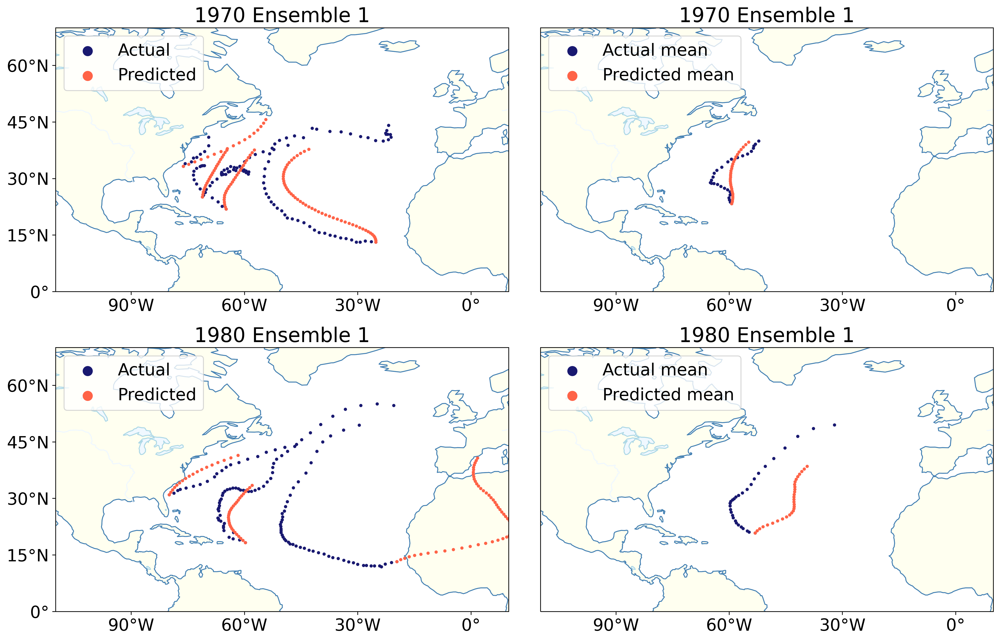

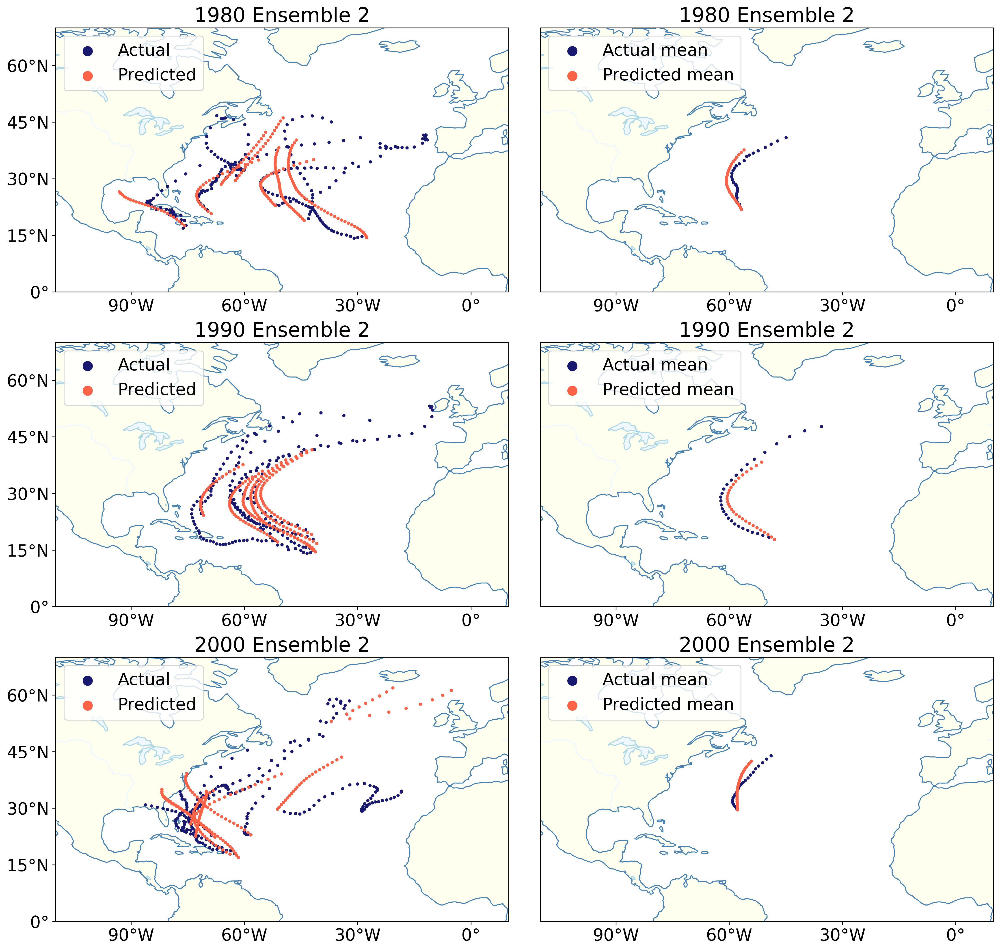

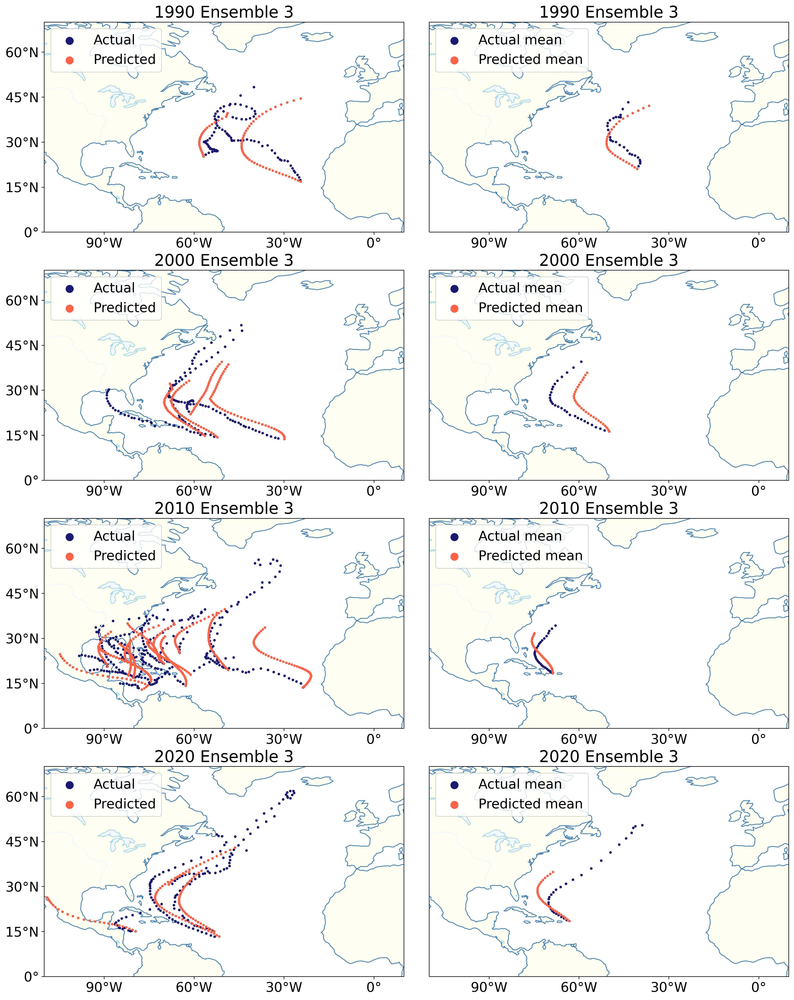

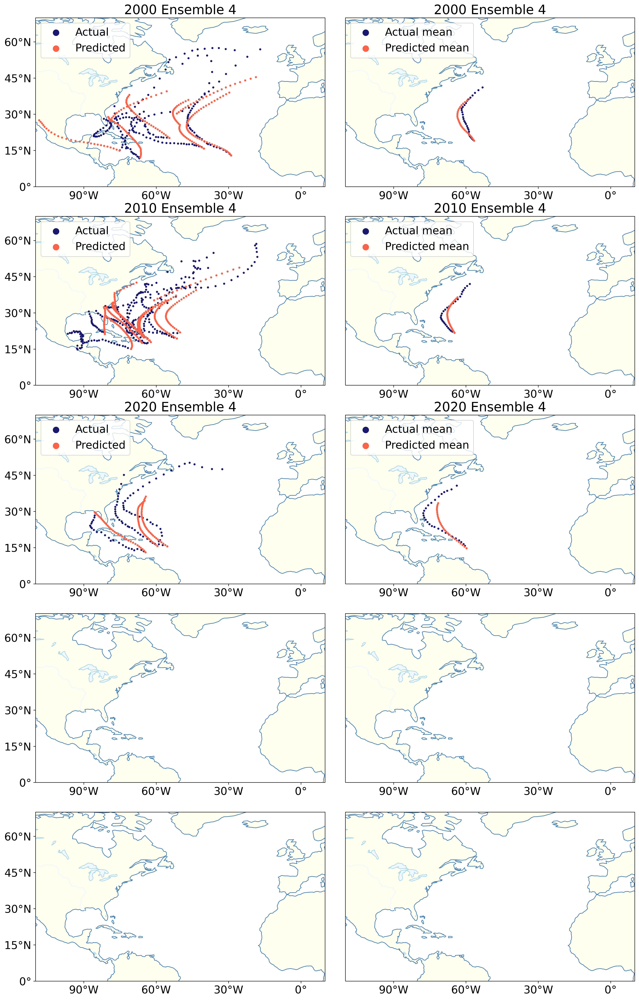

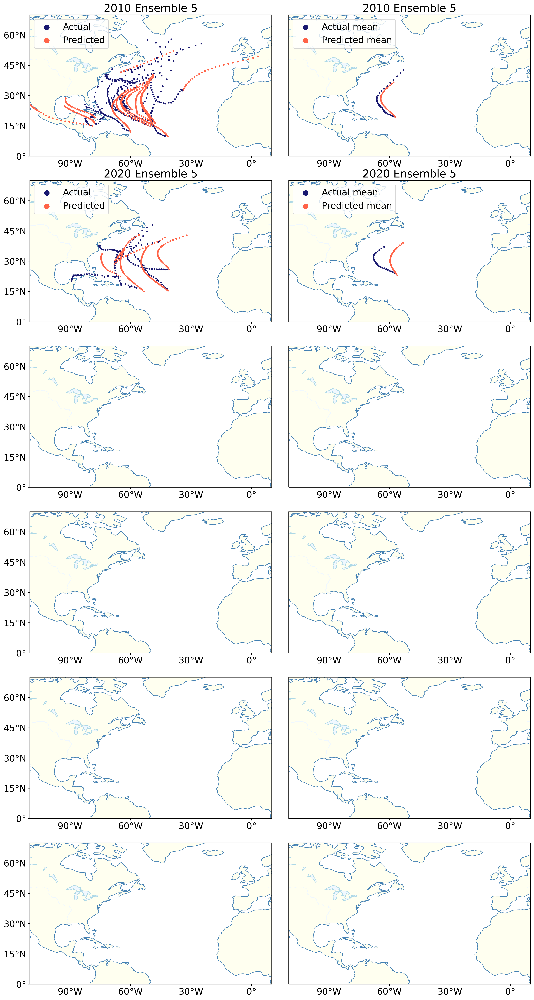

In [12]:
import predictions2
importlib.reload(predictions2)
for ensemble in range(5):
    predictions2.plot_tracks3(predicted, df5, range(1970+ensemble*10,1970+ensemble*20+20,10), ensemble)
    
    

In [6]:
import predictions_experiments2

import pickle
#run once to save intermediate data
# predictions_experiments2.save_predicted_boots(predictedL, hibestenses,lowbestenses,'data/predictedBoots2','data/predictedBootslow2')
# predictions_experiments2.save_predicted_boots(predicted, hibestenses,lowbestenses,'data/predictedBootsnoWind2','data/predictedBootslownoWind2')

# predictions_experiments2.save_predicted_boots(predicted4xL, hibestenses,lowbestenses,'data/predictedBoots4x2','data/predictedBootslow4x2')
# predictions_experiments2.save_predicted_boots(predicted4x, hibestenses,lowbestenses,'data/predictedBootsnoWind4x2','data/predictedBootslownoWind4x2')

with open('data/predictedBoots2', 'rb') as f:
    predictedBoots=pickle.load(f) 
        

with open('data/predictedBootslow2', 'rb') as f:
    predictedBootslow=pickle.load(f)    

with open('data/predictedBootsnoWind2', 'rb') as f:
    predictedBootsnoWind=pickle.load(f) 

with open('data/predictedBootslownoWind2', 'rb') as f:
    predictedBootslownoWind=pickle.load(f) 
    
with open('data/predictedBoots4x2', 'rb') as f:
    predictedBoots4x=pickle.load(f) 
        

with open('data/predictedBootslow4x2', 'rb') as f:
    predictedBootslow4x=pickle.load(f)    

with open('data/predictedBootsnoWind4x2', 'rb') as f:
    predictedBootsnoWind4x=pickle.load(f) 

with open('data/predictedBootslownoWind4x2', 'rb') as f:
    predictedBootslownoWind4x=pickle.load(f) 




In [2]:
#run once to save intermediate data
# import predictions_experiments2
# importlib.reload(predictions2)
# importlib.reload(predictions_experiments2)

# for genEns in range(0,10,1):
#     print(genEns)
#     predList = Parallel(n_jobs=52, verbose = 15)(delayed(predictions_experiments2.savepreds1)(df5Model, X2,ensemblesSLP, genEns, genYear, X1, modelLon,modelLat,modelLength, windmean2,False) for genYear in range(1970,2022,1))


  

In [3]:
#run once to save intermediate data
# import predictions_experiments2
# importlib.reload(predictions2)
# importlib.reload(predictions_experiments2)
# for genEns in range(0,10,1):
#     print(genEns)
#     predList = Parallel(n_jobs=52, verbose = 15)(delayed(predictions_experiments2.savepreds1)(df5Model_4x, X2_4x,ensemblesSLP, genEns, genYear, X1_4x, modelLon_4x,modelLat_4x,modelLength_4x, windmean2_4x,True) for genYear in range(1970,2022,1))




In [7]:
import predictions_experiments2

#run once to save intermediate data
# predAll = predictions_experiments2.load_predAll()
# predAll.to_csv('/tigress/gkortum/thesisSummer/predictions_experiments2/predicted_All.csv')
# predAll_4x= predictions_experiments2.load_predAll_4x()
# predAll_4x.to_csv('/tigress/gkortum/thesisSummer/predictions_experiments2/predicted_All_4x.csv')

predAll= pd.read_csv('/tigress/gkortum/thesisSummer/predictions_experiments2/predicted_All.csv').reset_index().drop('index',axis =1).iloc[:,1:]
predAll_4x= pd.read_csv('/tigress/gkortum/thesisSummer/predictions_experiments2/predicted_All_4x.csv').reset_index().drop('index',axis =1).iloc[:,1:]

In [8]:
import predictions_experiments2
importlib.reload(predictions_experiments2)
#run once to save intermediate data
# predictions_experiments2.save_prediction_experiments_2(predAll, hibestenses, lowbestenses,fourx = False)
# predictions_experiments2.save_prediction_experiments_2(predAll_4x, hibestenses, lowbestenses,fourx = True)  



with open('predictions_experiments2/SLPconsthiList', 'rb') as f:
    SLPconsthiList=pickle.load(f)  
with open('predictions_experiments2/SLPconstlowList', 'rb') as f:
    SLPconstlowList=pickle.load(f)   
with open('predictions_experiments2/genconsthiList', 'rb') as f:
    genconsthiList=pickle.load(f)  
with open('predictions_experiments2/genconstlowList', 'rb') as f:
    genconstlowList=pickle.load(f)  
with open('predictions_experiments2/SLPconsthiList_4x', 'rb') as f:
    SLPconsthiList4x=pickle.load(f)  
with open('predictions_experiments2/SLPconstlowList_4x', 'rb') as f:
    SLPconstlowList4x=pickle.load(f)   
with open('predictions_experiments2/genconsthiList_4x', 'rb') as f:
    genconsthiList4x=pickle.load(f)  
with open('predictions_experiments2/genconstlowList_4x', 'rb') as f:
    genconstlowList4x=pickle.load(f)  

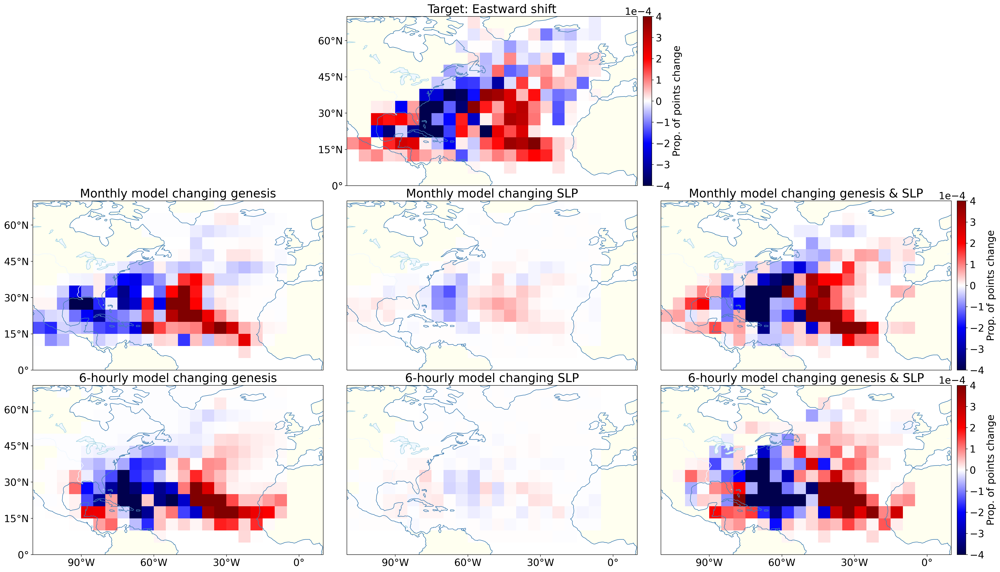

In [14]:
import plot_predictions_experiments

plot_predictions_experiments.densitySLP_gen2(lowbestdfs,genconstlowList,SLPconstlowList,predictedBootslownoWind, genconstlowList4x,SLPconstlowList4x,1,1,predictedBootslownoWind4x,norm =True)





In [9]:
def get_lists_ensembles(df5Model, predicted, predAll):
    theDFs2 = []
    thePreds = []
    theGenConst2=[]
    theSLPConst2=[]
    for theEns in range(10):
        #equivalent of hibestdfs[0]
        theDFs2.append(df5Model[df5Model['ensemble']==theEns])

        #equivalent of predictedBoots/ theArgs3
        thePreds.append(predicted[predicted['ensemble']==theEns])

        #equivalent of theArgs2/SLP/genconstlist

        #constant genesis

        genConst = predAll[predAll['slpEnsemble']==theEns]
        genConst = genConst[['currentlat','currentlon','slpYear','genEnsemble','genYear']]
        genConst.columns = ['lat','lon','year','setens','setyr']
        theGenConst2.append(genConst)
        SLPConst = predAll[predAll['genEnsemble']==theEns]
        SLPConst = SLPConst[['currentlat','currentlon','genYear','slpEnsemble','slpYear']]
        SLPConst.columns = ['lat','lon','year','setens','setyr']
        theSLPConst2.append(SLPConst)
    return theDFs2, thePreds, theGenConst2, theSLPConst2


def get_dfs_ensembles(df5Model, predicted, predAll):

    for theEns in range(10):
        if theEns ==0: 
            theDFs2= df5Model[df5Model['ensemble']==theEns]
        else: 
            #equivalent of hibestdfs[0]
            theDFs2=pd.concat([theDFs2,df5Model[df5Model['ensemble']==theEns]])
        if theEns ==0: 
            #equivalent of predictedBoots/ theArgs3
            thePreds=predicted[predicted['ensemble']==theEns]
        else: 
            thePreds=pd.concat([thePreds,predicted[predicted['ensemble']==theEns]])

            #equivalent of theArgs2/SLP/genconstlist

            #constant genesis

        genConst = predAll[predAll['slpEnsemble']==theEns]
        genConst = genConst[['currentlat','currentlon','slpYear','genEnsemble','genYear']]
        genConst.columns = ['lat','lon','year','setens','setyr']
        
        
        SLPConst = predAll[predAll['genEnsemble']==theEns]
        SLPConst = SLPConst[['currentlat','currentlon','genYear','slpEnsemble','slpYear']]
        SLPConst.columns = ['lat','lon','year','setens','setyr']
        if theEns==0: 
            theSLPConst2=SLPConst
            theGenConst2=genConst
        else: 
            theGenConst2=pd.concat([theGenConst2,genConst])
            theSLPConst2=pd.concat([theSLPConst2,SLPConst])  

    return theDFs2, thePreds, theGenConst2, theSLPConst2 
#run once to save intermediate data
# theDFs2_df, thePreds_df, theGenConst2_df, theSLPConst2_df=get_dfs_ensembles(df5Model, predicted, predAll)
# theDFs2_4x_df, thePreds_4x_df, theGenConst2_4x_df, theSLPConst2_4x_df=get_dfs_ensembles(df5Model_4x, predicted4x, predAll_4x)

theDFs2, thePreds, theGenConst2, theSLPConst2=get_lists_ensembles(df5Model, predicted, predAll)
theDFs2_4x, thePreds_4x, theGenConst2_4x, theSLPConst2_4x=get_lists_ensembles(df5Model_4x, predicted4x, predAll_4x)

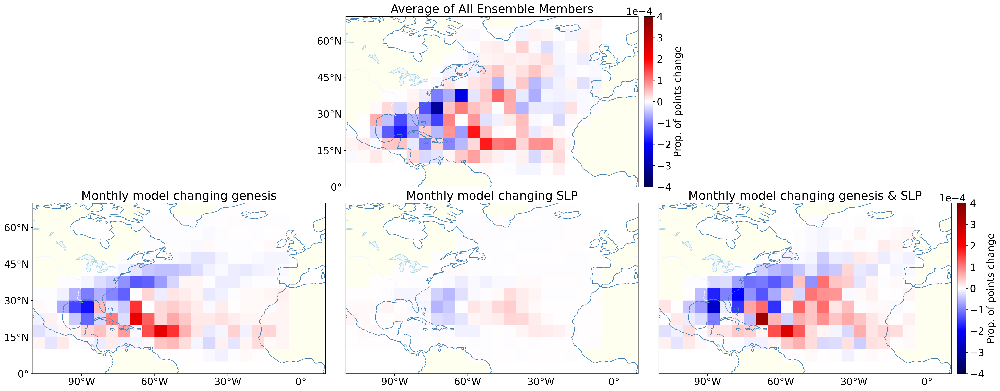

In [11]:
import plot_predictions_experiments
importlib.reload(plot_predictions_experiments)
plot_predictions_experiments.densitySLP_gen3(theDFs2,theGenConst2,theSLPConst2,thePreds,theGenConst2_4x,theSLPConst2_4x,1,1,thePreds_4x,norm =True, n_ens = 10)





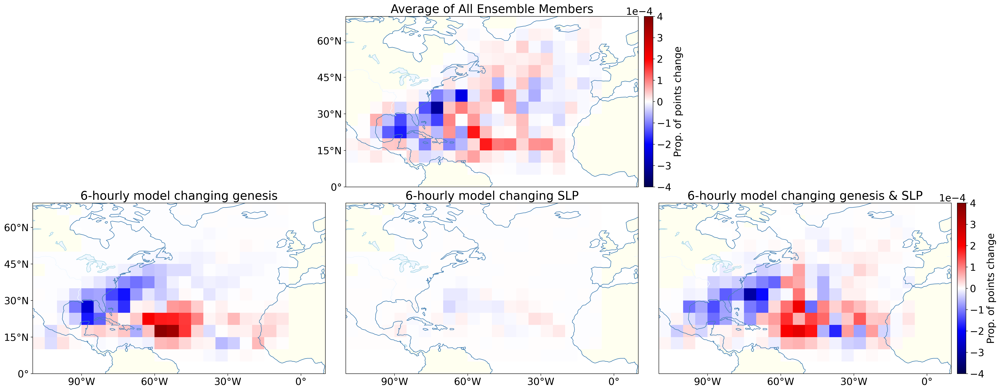

In [13]:
import plot_predictions_experiments
importlib.reload(plot_predictions_experiments)
plot_predictions_experiments.densitySLP_gen4(theDFs2,theGenConst2,theSLPConst2,thePreds,theGenConst2_4x,theSLPConst2_4x,1,1,thePreds_4x,norm =True, n_ens = 10)





In [16]:
theArgs3 = [predictedBoots,
            predictedBootslow,
            predictedBootsnoWind,
            predictedBootslownoWind,
            predictedBoots4x,
            predictedBootslow4x,
            predictedBootsnoWind4x,
            predictedBootslownoWind4x,
            1,1,1,1]
theArgs2 = [SLPconsthiList,
            SLPconstlowList,
            genconsthiList,
            genconstlowList,
            SLPconsthiList4x,
            SLPconstlowList4x,
            genconsthiList4x,
            genconstlowList4x,
           1,1,1,1]

In [14]:
import plot_predictions_experiments
importlib.reload(plot_predictions_experiments)
#run once to save intermediate data
# rsm1, rsm2= plot_predictions_experiments.Hs_gens_hists(theArgs2,hibestdfs,lowbestdfs,100)
# with open('data/rsm1_2', 'wb') as f:
#     pickle.dump(rsm1,f)  
# with open('data/rsm2_2', 'wb') as f:
#     pickle.dump(rsm2,f) 
with open('data/rsm1_2', 'rb') as f:
    rsm1 = pickle.load(f)  
with open('data/rsm2_2', 'rb') as f:
    rsm2 = pickle.load(f)   

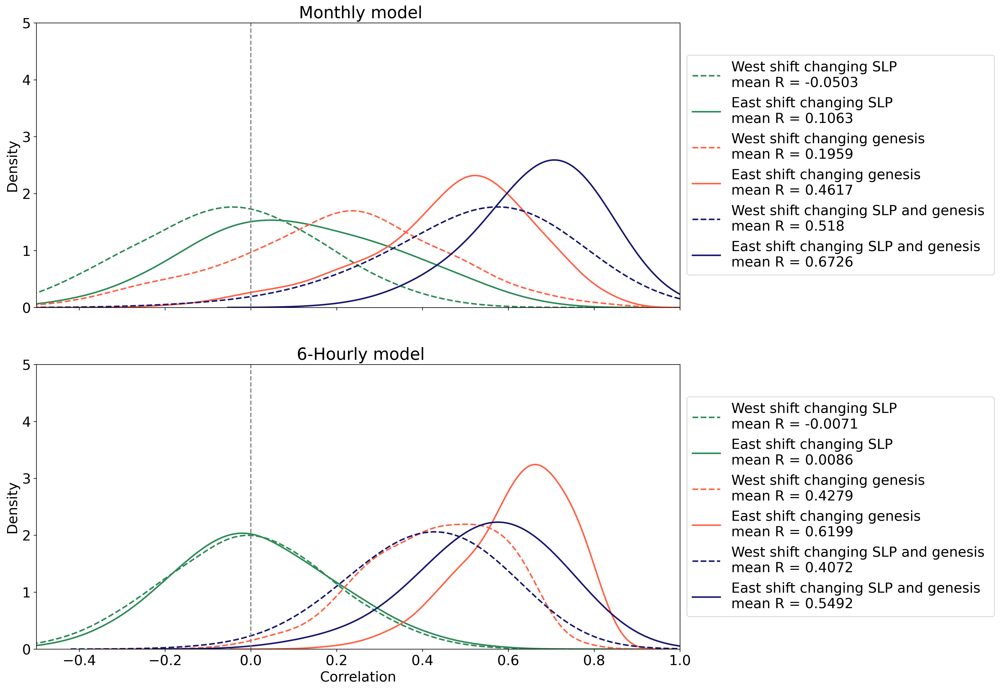

In [17]:
importlib.reload(plot_predictions_experiments)
plot_predictions_experiments.plot_Hs_gens_hists(rsm1, rsm2, theArgs3,hibestdfs,lowbestdfs)



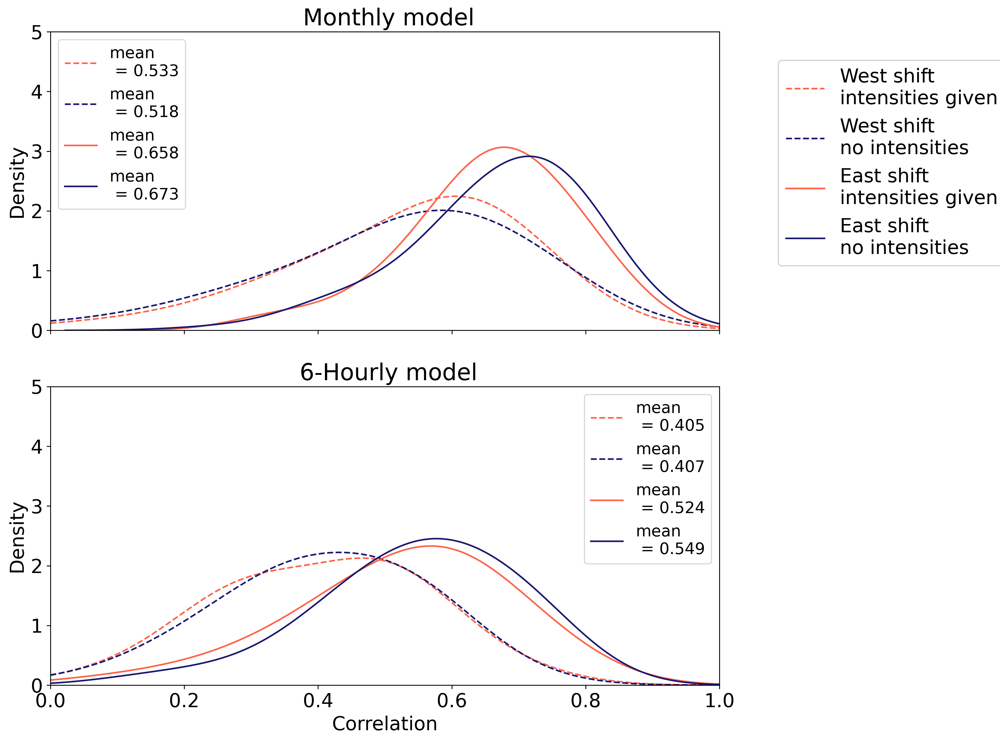

In [18]:
plot_predictions_experiments.Hs_errs_hists(theArgs3,hibestdfs,lowbestdfs,100)



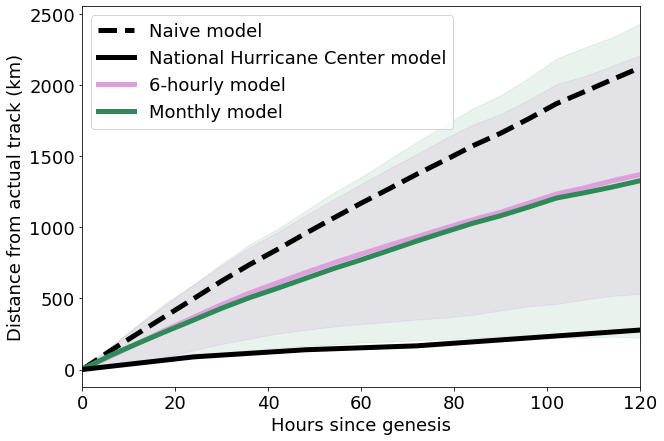

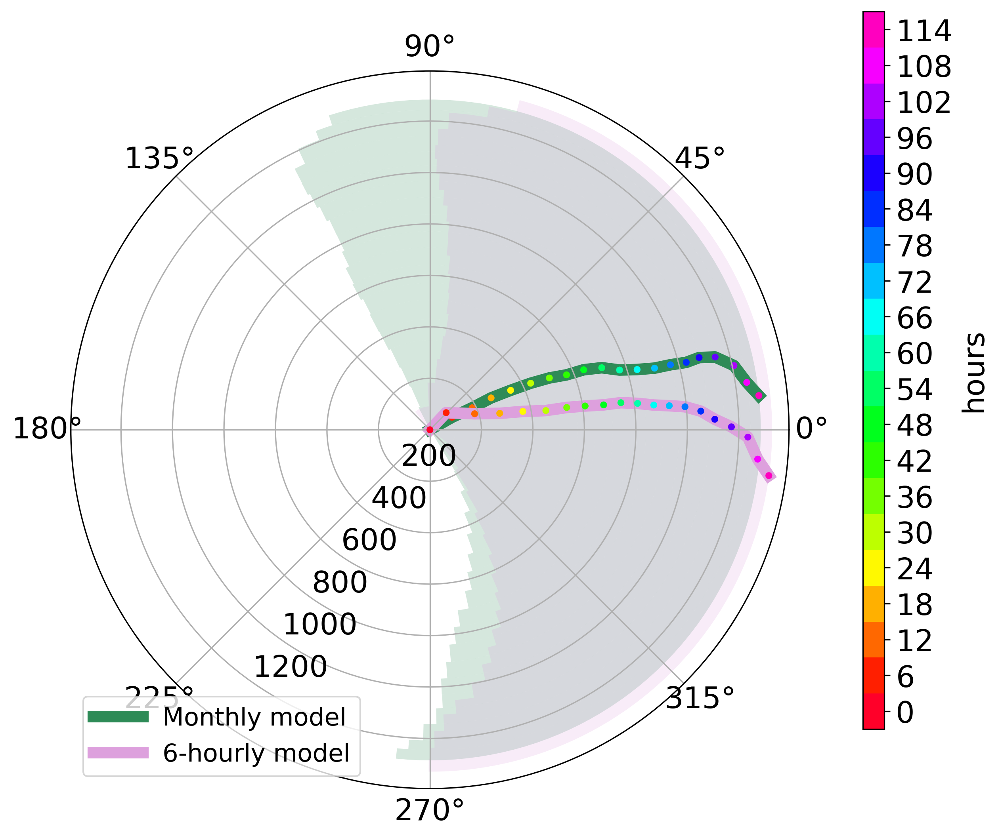

In [24]:
import prediction_errors
importlib.reload(prediction_errors)
prediction_errors.plot_errors(predicted, df5Model, X2, X1, modelLon,modelLat,predicted4x, df5Model_4x, X2_4x, X1_4x, modelLon_4x,modelLat_4x,predictedL,predicted4xL)


